In [139]:
import os
import warnings
import pandas as pd
import numpy as np
from os import path
import data_process_xd as dp
import draw_map_xd as dm
import get_Mode as gm
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.metrics import f1_score, plot_confusion_matrix,accuracy_score, confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.pipeline import make_pipeline
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import RandomizedSearchCV
from sklearn.model_selection import GridSearchCV
warnings. filterwarnings("ignore")
from sklearn.metrics import classification_report

Load london march to june month data

In [140]:
data_dir = "../data/london_data"
london_with_station = pd.read_csv(path.join(data_dir, "toby_stofan_process.csv"))


In [141]:
london_with_station_time = dp.add_time_feature_station(london_with_station, t=37)


In [142]:
train_london = london_with_station_time

In [143]:
train_london.loc[train_london['activity'] == 'Running', 'activity'] = 'Walking/running'
train_london.loc[train_london['activity'] == 'Walking', 'activity'] = 'Walking/running'

In [ ]:
chosen_columns_bus = ['pm1', 'pm2_5', 'pm10', 'temperature', 'humidity','bin0', 'bin1', 'bin2', 'bin3', 'bin4', 'bin5', 'bin6', 'bin7', 'bin8',
                  'bin9', 'bin10', 'bin11', 'bin12', 'bin13', 'bin14', 'bin15', 'gps_dist', 'gps_dist_std',
                  'highway_encode', 'distance', 'landuse_encode', 'station_encode','station_distance',
                  'avg_dist', 'same_road', 'same_land',]

In [145]:
# chosen_columns_bus = ['pm1', 'pm2_5', 'pm10', 'temperature',
#        'humidity', 'bin0', 'bin1', 'bin2', 'bin3', 'bin4', 'bin5', 'bin6',
#        'bin7', 'bin8', 'bin9', 'bin10', 'bin11', 'bin12', 'bin13', 'bin14',
#        'bin15','gpsLongitude', 'gpsLatitude', 'gps_dist',
#        'gps_dist_std', 'highway_encode', 'landuse_encode','distance',
#        'station_encode','avg_dist', 'same_road', 'same_land']


In [173]:
X_bus = train_london[chosen_columns_bus]
X_bus = X_bus.dropna(axis = 0)
y = train_london['activity']

In [147]:
X_bus_train, X_bus_test, y_bus_train, y_bus_test = train_test_split(X_bus, y, test_size=0.33, random_state=0)

In [148]:
categories = ['In the car','On the bus','On the train','On the tube','Riding a bike','Walking/running']

Score: 0.9749541844838119
F1 Score: 0.9749405299629154


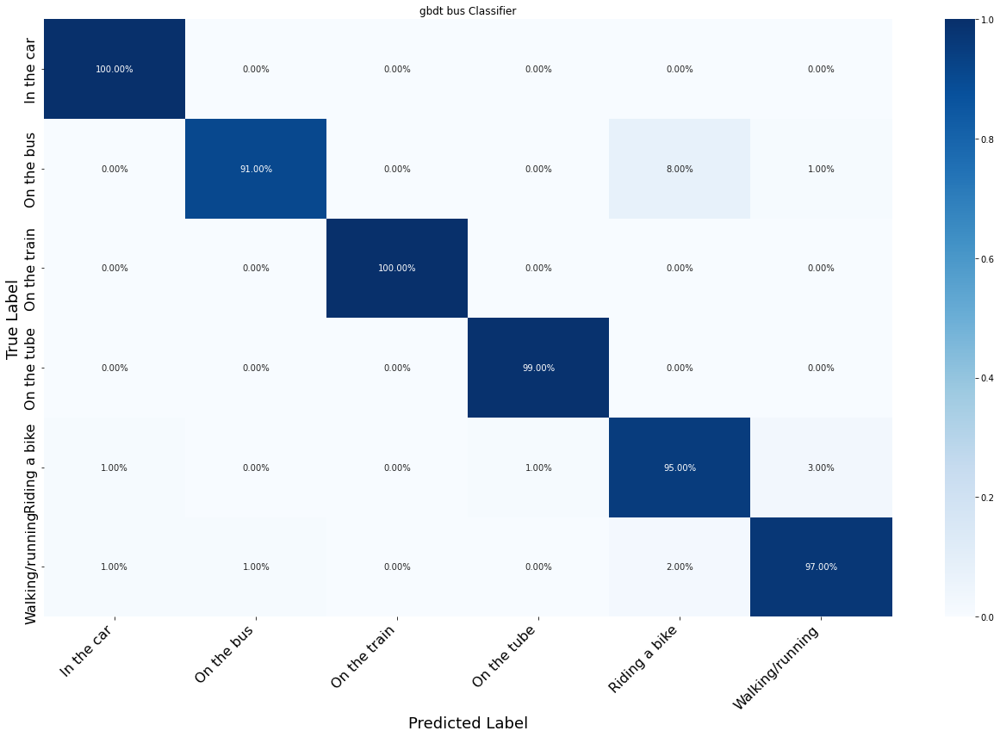

In [149]:
#gbr = GradientBoostingClassifier(n_estimators=1000, max_depth=5, min_samples_split=2, learning_rate=0.01)
gbr = GradientBoostingClassifier(n_estimators= 1300,
     min_samples_split= 5,
     min_samples_leaf = 1,
     max_features  = 'sqrt',
     max_depth = 80,
     learning_rate = 0.1)
# gbr =GradientBoostingClassifier()
gbr.fit(X_bus_train,y_bus_train)
y_preds = gbr.predict(X_bus_test)
print("Score: {}".format(gbr.score(X_bus_test, y_bus_test)))
print("F1 Score: {}".format(f1_score(y_bus_test, y_preds, average='weighted')))
dp.plot_confusionMatrix(y_bus_test, y_preds,  display_names=categories, normalize='true', plot_numbers=True)
plt.title('gbdt bus Classifier')
plt.tight_layout()

In [150]:
importances = gbr.feature_importances_
indices = np.argsort(importances)[::-1]
features = []
importance = []
for f in range(X_bus_train.shape[1]):
    features.append(X_bus_train.columns[indices[f]])
    importance.append(importances[indices[f]])
out = pd.DataFrame()
out['Feature'] = features
out['Importance'] = importance
out

,Feature,Importance
0,gps_dist_std,0.120723
1,pm1,0.103840
2,pm2_5,0.094508
3,gpsLongitude,0.075707
4,gpsLatitude,0.073995
5,distance,0.069044
6,temperature,0.053006
7,gps_dist,0.045863
8,bin1,0.045850
9,avg_dist,0.041923


apply on inhale data

In [151]:
inh = pd.read_csv('../data/london_data/inout_results2/INH001(1)inout_predict.csv')

In [152]:
london_station = dp.load_station('toby_new')

In [153]:
inh_test = inh.loc[inh['i/o'] == 1]

In [154]:
inh_test.columns

Index(['Unnamed: 0', 'timestamp', 'pm1', 'pm2_5', 'pm10', 'temperature',
       'humidity', 'bin0', 'bin1', 'bin2', 'bin3', 'bin4', 'bin5', 'bin6',
       'bin7', 'bin8', 'bin9', 'bin10', 'bin11', 'bin12', 'bin13', 'bin14',
       'bin15', 'total', 'gpsLongitude', 'gpsLatitude', 'gpsAltitude',
       'gpsAccuracy', 'luxLevel', 'motion', 'battery', 'geometry', 'highway',
       'distance', 'close_road_idx', 'landuse', 'close_land_idx', 'gps_dist',
       'gps_dist_std', 'highway_encode', 'landuse_encode', 'i/o', 'home_dist',
       'work_dist'],
      dtype='object')

In [155]:
inh_test = dp.add_station_feature(london_station,inh_test)

In [156]:
inh_test = dp.add_time_feature_station(inh_test, t=37)

In [157]:
inh_test1 = inh_test

In [158]:
inh_test1['timestamp'] = pd.to_datetime(inh_test1['timestamp'])
inh_test1 = inh_test1.sort_values(by='timestamp')

In [159]:
inh_test1['hour']= inh_test1['timestamp'].dt.hour

In [160]:
inh_test1 = inh_test1.loc[(inh_test1['hour'] >= 6)]

In [161]:
inh_test1 = inh_test1.loc[(inh_test1['hour']<= 19)]


In [162]:
X = inh_test1[chosen_columns_bus]
y_pred = gbr.predict(X)
inh_test1['mode'] = y_pred


In [163]:
np.unique(inh_test1['mode'],return_counts=True)

(array(['In the car', 'On the bus', 'Riding a bike', 'Walking/running'],
       dtype=object),
 array([  20, 4505,   35, 7826]))

In [164]:
import folium
def getMode1(coords, df, label_col, transport=False, classification=False, line=False):
    # draw the map, if classification=True, draw different class with different colors
    # Maps © www.thunderforest.com, Data © www.osm.org/copyright
    m = folium.Map(location=coords[0], zoom_start=12)
    if transport:
        m = folium.Map(location=coords[0], zoom_start=12, tiles = 'https://tile.thunderforest.com/transport/{z}/{x}/{y}.png?apikey=79284124c2f24955b9cd0d84c306bd0d', attr= "Transport")
    cs = []
    colour = 'red'
    for i,c in enumerate(coords):
        if classification==True:
            mode = df.iloc[i][label_col]
            if mode == 'In the car': ## 'In the car'
                colour = 'darkgreen'
            elif mode == 'On the bus': ##  'On the bus'
                colour = 'deepskyblue'
            elif mode == 'On the train': ## 'On the train'
                colour = 'yellow'
            elif mode == 'On the tube': ## 'On the tube'
                colour == 'red'
            elif mode == 'Riding a bike': ## 'Riding a bike'
                colour = 'darkorange'
            elif mode == 'Walking/running': ## 'walking/running'
                colour = 'indigo'

            
        coord = c
        cs.append(coord)
        
        label = "Coords: {0}".format(c)
        if classification== True:
            label += "\n Classification: {0}".format(mode)
        
        folium.Circle(
            radius=10,
            location=coord,
            popup=label,
            color=colour,
            fill=True,
        ).add_to(m)
    
    if line==True:
        folium.PolyLine(cs).add_to(m)
    return m

In [165]:
c = gm.getCoords(inh_test1)
getMode1(c,inh_test1,'mode',classification=True)


def predict_asthma(patient_type):
    filePath = './data/london_data/'+ patient_type
    patient_filename = os.listdir(filePath)
    patient_filename.sort()
    london_station = dp.load_station('toby_new')


    chosen_columns_bus = ['pm1', 'pm2_5', 'pm10', 'temperature', 'humidity','bin0', 'bin1', 'bin2', 'bin3', 'bin4', 'bin5', 'bin6', 'bin7', 'bin8',
                  'bin9', 'bin10', 'bin11', 'bin12', 'bin13', 'bin14', 'bin15', 'gps_dist', 'gps_dist_std',
                  'highway_encode', 'distance', 'landuse_encode', 'station_encode','station_distance',
                  'avg_dist', 'same_road', 'same_land',]
    Required_columns = ['timestamp','pm1','pm2_5','pm10','gpsLongitude','gpsLatitude','gpsAltitude','i/o','mode']
    for i in range(len(patient_filename)):
        patient_data = pd.read_csv('./data/london_data/' + patient_type + '/' + patient_filename[i])
        #load osm data

        patient_osm = patient_data.loc[patient_data['i/o'] == 1]

        patient_osm = dp.add_station_feature(london_station, patient_osm)

        patient_osm = dp.add_time_feature_station(patient_osm,t =37)

        # predict data
        test_x = patient_osm[chosen_columns_bus]
        test_pre = gbr.predict(test_x)
        patient_osm['mode'] = test_pre



        patient_re = patient_osm[Required_columns]


        print("successful generate" + patient_filename[i].split('_')[0])

        patient_re.to_csv('./data/london_data/mode_results/' + patient_filename[i].split('_')[0] + '_mode_gbr_predict.csv')


In [171]:
def predict_asthma(patient_type):
    filePath = '../data/london_data/'+ patient_type
    patient_filename = os.listdir(filePath)
    patient_filename.sort()
    london_station = dp.load_station('toby_new')


    chosen_columns_bus = ['pm1', 'pm2_5', 'pm10', 'temperature',
       'humidity', 'bin0', 'bin1', 'bin2', 'bin3', 'bin4', 'bin5', 'bin6',
       'bin7', 'bin8', 'bin9', 'bin10', 'bin11', 'bin12', 'bin13', 'bin14',
       'bin15','gpsLongitude', 'gpsLatitude', 'gps_dist',
       'gps_dist_std', 'highway_encode', 'landuse_encode','distance',
       'station_encode','avg_dist', 'same_road', 'same_land']

    Required_columns = ['timestamp','pm1','pm2_5','pm10','gpsLongitude','gpsLatitude','gpsAltitude','i/o','mode']
    for i in range(len(patient_filename)):
        patient_data = pd.read_csv('../data/london_data/' + patient_type + '/' + patient_filename[i])
        #load osm data

        patient_osm = patient_data.loc[patient_data['i/o'] == 1]

        patient_osm = dp.add_station_feature(london_station, patient_osm)

        patient_osm = dp.add_time_feature_station(patient_osm,t =37)

        patient_osm['timestamp'] = pd.to_datetime(patient_osm['timestamp'])
        patient_osm = patient_osm.sort_values(by='timestamp')
        patient_osm['hour']= patient_osm['timestamp'].dt.hour
        patient_osm = patient_osm.loc[(patient_osm['hour'] >= 6)]
        patient_osm = patient_osm.loc[(patient_osm['hour']<= 19)]


        # predict data
        test_x = patient_osm[chosen_columns_bus]
        test_pre = gbr.predict(test_x)
        patient_osm['mode'] = test_pre



        patient_re = patient_osm[Required_columns]


        print("successful generate" + patient_filename[i].split('_')[0])

        patient_re.to_csv('../data/london_data/mode_result_t37/' + patient_filename[i].split('_')[0] + '_mode_gbr_predict.csv')

In [172]:
predict_asthma('inout_results2')


successful generateINH001(1)inout
successful generateINH001(2)inout
successful generateINH002(1)inout
successful generateINH003(1)inout
successful generateINH003(2)inout
successful generateINH004(1)inout
successful generateINH005(1)inout
successful generateINH006(1)inout
successful generateINH007(1)inout
successful generateINH101(1)inout
successful generateINH101(2)inout
successful generateINH102(1)inout
successful generateINH102(2)inout
successful generateINH103(1)inout
successful generateINH104(1)inout
successful generateINH106(1)inout
successful generateINH107(1)inout
successful generateINH108(1)inout
successful generateINH114(1)inout
